In [65]:
import os
from pathlib import Path

import missingno as msno
import pandas as pd
from src.data_acquisition.entso_e.entso_e import EntsoeHook
from src.data_acquisition.epex_sftp.intraday_transactions_new_format import (
    execute_etl_transactions_new_format,
)
from src.data_acquisition.epex_sftp.intraday_transactions_old_format import (
    execute_etl_transactions_old_format,
)
from src.data_acquisition.postgres_db.postgres_db_hooks import ThesisDBHook
from dateutil.relativedelta import relativedelta
from dotenv import load_dotenv

import importlib, src.data_acquisition.entso_e.entso_e as entsoe_mod
importlib.reload(entsoe_mod)
from src.data_acquisition.entso_e.entso_e import fill_database_with_entsoe_data

from src.data_acquisition.epex_sftp.build_idfull import run_build_idfull_and_merge

from src.shared.config import DATA_START, DATA_END, PRECOMPUTED_VWAP_PATH
from src.data_acquisition.epex_sftp.precompute_vwaps import precompute_range


load_dotenv()

pd.options.plotting.backend = "plotly"
POSTGRES_USERNAME = os.getenv("POSTGRES_USER")
POSTGRES_DB_HOST = os.getenv("POSTGRES_DB_HOST")

# ETL ENTSO-E data into DB

In [27]:
start = pd.Timestamp(2019, 1, 1, tz="Europe/Berlin")
end   = pd.Timestamp(2025, 1, 1, tz="Europe/Berlin")

In [28]:
fill_database_with_entsoe_data(start, end)


[INFO] Processing 2019-01-01 → 2019-02-01


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:33:33.704 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:33.705 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:33.834 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2018-12-31T23:00:00+00:00 to 2019-01-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:33.834 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:33:34.132 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:34.133 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:34.206 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2018-12-31T23:00:00+00:00 to 2019-01-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:34.207 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:33:34.514 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:111 - Table entsoe_forecasts created successfully.
2025-12-02 15:33:34.515 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:34.617 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2018-12-31T23:00:00+00:00 to 2019-01-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:33:34.619 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:33:35.559 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:33:35.560 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2549


2025-12-02 15:33:35.935 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2018-12-31T23:00:00+00:00 to 2019-01-27T12:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:35.936 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2019-02-01 → 2019-03-01


2025-12-02 15:33:36.237 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:36.237 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:36.302 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-01-31T23:00:00+00:00 to 2019-02-28T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:36.302 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 673
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:33:36.583 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:36.583 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:36.644 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-01-31T23:00:00+00:00 to 2019-02-28T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:36.644 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 673
  → inserted DA 15min


2025-12-02 15:33:36.993 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:33:36.993 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:37.065 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-01-31T23:00:00+00:00 to 2019-02-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:33:37.065 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:33:37.774 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:33:37.774 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2156


2025-12-02 15:33:38.103 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-01-31T23:00:00+00:00 to 2019-02-23T09:45:00+00:00 has been written to DB successfully.
2025-12-02 15:33:38.103 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2019-03-01 → 2019-04-01


2025-12-02 15:33:38.379 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:38.379 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:38.448 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-02-28T23:00:00+00:00 to 2019-03-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:38.448 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 744
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:33:38.761 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:38.762 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:38.824 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-02-28T23:00:00+00:00 to 2019-03-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:38.825 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 744
  → inserted DA 15min


2025-12-02 15:33:39.091 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:33:39.091 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:39.201 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-02-28T23:00:00+00:00 to 2019-03-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:33:39.201 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:33:39.867 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:33:39.867 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1890


2025-12-02 15:33:40.155 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-02-28T23:00:00+00:00 to 2019-03-20T15:15:00+00:00 has been written to DB successfully.
2025-12-02 15:33:40.155 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2019-04-01 → 2019-05-01


2025-12-02 15:33:40.519 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:40.520 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:40.586 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-03-31T22:00:00+00:00 to 2019-04-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:40.586 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:33:40.853 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:40.854 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:40.915 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-03-31T22:00:00+00:00 to 2019-04-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:40.916 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:33:41.177 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:33:41.177 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:41.253 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-03-31T22:00:00+00:00 to 2019-04-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:33:41.253 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:33:41.893 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:33:41.894 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1682


2025-12-02 15:33:42.171 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-03-31T22:00:00+00:00 to 2019-04-18T10:15:00+00:00 has been written to DB successfully.
2025-12-02 15:33:42.171 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2019-05-01 → 2019-06-01


2025-12-02 15:33:42.440 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:42.440 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:42.510 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-04-30T22:00:00+00:00 to 2019-05-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:42.510 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:33:42.741 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:42.741 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:42.808 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-04-30T22:00:00+00:00 to 2019-05-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:42.808 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:33:43.124 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:33:43.125 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:43.196 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-04-30T22:00:00+00:00 to 2019-05-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:33:43.196 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:33:44.191 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:33:44.191 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1488


2025-12-02 15:33:44.452 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-04-30T22:00:00+00:00 to 2019-05-16T09:45:00+00:00 has been written to DB successfully.
2025-12-02 15:33:44.452 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2019-06-01 → 2019-07-01


2025-12-02 15:33:44.696 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:44.697 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:44.765 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-05-31T22:00:00+00:00 to 2019-06-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:44.765 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:33:45.010 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:45.011 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:45.076 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-05-31T22:00:00+00:00 to 2019-06-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:45.077 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:33:45.472 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:33:45.472 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:45.545 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-05-31T22:00:00+00:00 to 2019-06-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:33:45.545 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:33:46.423 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:33:46.423 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1374


2025-12-02 15:33:46.656 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-05-31T22:00:00+00:00 to 2019-06-15T05:15:00+00:00 has been written to DB successfully.
2025-12-02 15:33:46.658 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2019-07-01 → 2019-08-01


2025-12-02 15:33:46.901 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:46.902 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:46.964 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-06-30T22:00:00+00:00 to 2019-07-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:46.965 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:33:47.218 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:47.219 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:47.283 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-06-30T22:00:00+00:00 to 2019-07-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:47.283 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:33:47.581 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:33:47.581 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:47.657 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-06-30T22:00:00+00:00 to 2019-07-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:33:47.657 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:33:48.387 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:33:48.388 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1382


2025-12-02 15:33:48.611 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-06-30T22:00:00+00:00 to 2019-07-15T07:15:00+00:00 has been written to DB successfully.
2025-12-02 15:33:48.611 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2019-08-01 → 2019-09-01


2025-12-02 15:33:51.625 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:51.626 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:51.709 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-07-31T22:00:00+00:00 to 2019-08-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:51.709 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:33:51.951 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:51.952 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:52.018 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-07-31T22:00:00+00:00 to 2019-08-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:52.018 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:33:52.408 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:33:52.408 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:52.483 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-07-31T22:00:00+00:00 to 2019-08-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:33:52.483 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:33:53.074 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:33:53.074 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1503


2025-12-02 15:33:53.313 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-07-31T22:00:00+00:00 to 2019-08-16T13:30:00+00:00 has been written to DB successfully.
2025-12-02 15:33:53.314 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2019-09-01 → 2019-10-01


2025-12-02 15:33:53.598 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:53.599 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:53.698 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-08-31T22:00:00+00:00 to 2019-09-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:53.698 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:33:54.034 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:54.035 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:54.097 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-08-31T22:00:00+00:00 to 2019-09-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:54.098 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:33:54.363 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:33:54.363 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:54.436 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-08-31T22:00:00+00:00 to 2019-09-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:33:54.436 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:33:55.024 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:33:55.024 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1712


2025-12-02 15:33:55.290 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-08-31T22:00:00+00:00 to 2019-09-18T17:45:00+00:00 has been written to DB successfully.
2025-12-02 15:33:55.290 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2019-10-01 → 2019-11-01


2025-12-02 15:33:55.548 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:55.549 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 746


2025-12-02 15:33:55.733 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-09-30T22:00:00+00:00 to 2019-10-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:55.734 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted DA 60min


2025-12-02 15:33:55.967 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:55.968 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:56.031 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-09-30T22:00:00+00:00 to 2019-10-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:56.031 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 746
  → inserted DA 15min


2025-12-02 15:33:56.333 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:33:56.333 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:56.407 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-09-30T22:00:00+00:00 to 2019-10-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:33:56.408 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:33:57.091 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:33:57.092 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2050


2025-12-02 15:33:57.412 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-09-30T22:00:00+00:00 to 2019-10-22T06:15:00+00:00 has been written to DB successfully.
2025-12-02 15:33:57.413 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2019-11-01 → 2019-12-01


2025-12-02 15:33:57.678 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:57.679 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:57.746 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-10-31T23:00:00+00:00 to 2019-11-30T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:57.746 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:33:57.990 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:57.990 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:58.054 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-10-31T23:00:00+00:00 to 2019-11-30T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:58.055 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:33:58.385 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:33:58.385 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:58.457 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-10-31T23:00:00+00:00 to 2019-11-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:33:58.457 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:33:59.147 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:33:59.147 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2371


2025-12-02 15:33:59.494 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-10-31T23:00:00+00:00 to 2019-11-25T15:30:00+00:00 has been written to DB successfully.
2025-12-02 15:33:59.495 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2019-12-01 → 2020-01-01


2025-12-02 15:33:59.769 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:33:59.769 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:33:59.831 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-11-30T23:00:00+00:00 to 2019-12-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:33:59.832 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:00.089 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:00.089 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:00.152 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-11-30T23:00:00+00:00 to 2019-12-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:00.152 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:34:00.490 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:00.490 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:00.562 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-11-30T23:00:00+00:00 to 2019-12-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:00.562 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:01.366 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:01.367 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2722


2025-12-02 15:34:01.759 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-11-30T23:00:00+00:00 to 2019-12-29T07:15:00+00:00 has been written to DB successfully.
2025-12-02 15:34:01.760 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2020-01-01 → 2020-02-01


2025-12-02 15:34:02.034 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:02.034 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:02.096 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-12-31T23:00:00+00:00 to 2020-01-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:02.097 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:02.377 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:02.378 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:02.444 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2019-12-31T23:00:00+00:00 to 2020-01-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:02.444 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:34:02.728 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:02.729 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:02.801 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-12-31T23:00:00+00:00 to 2020-01-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:02.802 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:03.504 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:03.505 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2552


2025-12-02 15:34:03.875 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2019-12-31T23:00:00+00:00 to 2020-01-27T12:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:03.876 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2020-02-01 → 2020-03-01


2025-12-02 15:34:04.173 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:04.173 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:04.235 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-01-31T23:00:00+00:00 to 2020-02-29T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:04.236 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 697
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:04.470 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:04.471 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:04.529 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-01-31T23:00:00+00:00 to 2020-02-29T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:04.530 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 697
  → inserted DA 15min


2025-12-02 15:34:04.825 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:04.826 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:04.903 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-01-31T23:00:00+00:00 to 2020-02-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:04.904 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:05.665 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:05.665 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2185


2025-12-02 15:34:05.989 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-01-31T23:00:00+00:00 to 2020-02-23T17:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:05.989 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2020-03-01 → 2020-04-01


2025-12-02 15:34:06.275 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:06.276 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:06.341 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-02-29T23:00:00+00:00 to 2020-03-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:06.342 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 744
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:06.583 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:06.584 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:06.652 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-02-29T23:00:00+00:00 to 2020-03-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:06.652 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 744
  → inserted DA 15min


2025-12-02 15:34:07.074 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:07.074 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:07.153 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-02-29T23:00:00+00:00 to 2020-03-11T09:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:07.153 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1001
  → inserted load forecast


2025-12-02 15:34:07.824 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:07.825 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1948


2025-12-02 15:34:08.119 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-02-29T23:00:00+00:00 to 2020-03-21T05:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:08.119 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2020-04-01 → 2020-05-01


2025-12-02 15:34:08.388 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:08.388 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:08.452 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-03-31T22:00:00+00:00 to 2020-04-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:08.452 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:08.820 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:08.821 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:08.884 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-03-31T22:00:00+00:00 to 2020-04-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:08.885 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:34:09.506 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:09.507 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:09.583 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-03-31T22:00:00+00:00 to 2020-04-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:09.583 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:10.390 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:10.390 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1678


2025-12-02 15:34:10.650 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-03-31T22:00:00+00:00 to 2020-04-18T09:15:00+00:00 has been written to DB successfully.
2025-12-02 15:34:10.651 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2020-05-01 → 2020-06-01


2025-12-02 15:34:10.988 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:10.989 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:11.054 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-04-30T22:00:00+00:00 to 2020-05-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:11.055 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:11.328 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:11.328 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:11.392 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-04-30T22:00:00+00:00 to 2020-05-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:11.392 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:34:11.687 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:11.688 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:11.762 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-04-30T22:00:00+00:00 to 2020-05-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:11.762 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:12.443 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:12.443 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1484


2025-12-02 15:34:12.778 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-04-30T22:00:00+00:00 to 2020-05-16T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:12.779 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2020-06-01 → 2020-07-01


2025-12-02 15:34:13.053 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:13.054 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:13.127 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-05-31T22:00:00+00:00 to 2020-06-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:13.127 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:13.387 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:13.388 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:13.454 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-05-31T22:00:00+00:00 to 2020-06-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:13.455 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:34:14.306 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:14.307 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:14.383 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-05-31T22:00:00+00:00 to 2020-06-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:14.383 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:15.191 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:15.191 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1369


2025-12-02 15:34:15.414 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-05-31T22:00:00+00:00 to 2020-06-15T04:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:15.414 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2020-07-01 → 2020-08-01


2025-12-02 15:34:15.685 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:15.685 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:15.749 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-06-30T22:00:00+00:00 to 2020-07-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:15.750 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:15.992 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:15.993 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:16.062 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-06-30T22:00:00+00:00 to 2020-07-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:16.062 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:34:16.346 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:16.346 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:16.418 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-06-30T22:00:00+00:00 to 2020-07-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:16.418 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:17.113 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:17.113 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1383


2025-12-02 15:34:17.379 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-06-30T22:00:00+00:00 to 2020-07-15T07:30:00+00:00 has been written to DB successfully.
2025-12-02 15:34:17.379 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2020-08-01 → 2020-09-01


2025-12-02 15:34:17.658 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:17.658 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:17.728 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-07-31T22:00:00+00:00 to 2020-08-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:17.728 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:18.011 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:18.011 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:18.074 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-07-31T22:00:00+00:00 to 2020-08-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:18.074 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:34:18.359 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:18.360 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:18.433 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-07-31T22:00:00+00:00 to 2020-08-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:18.434 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:19.281 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:19.281 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1504


2025-12-02 15:34:19.551 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-07-31T22:00:00+00:00 to 2020-08-16T13:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:19.552 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2020-09-01 → 2020-10-01


2025-12-02 15:34:19.793 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:19.794 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:19.859 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-08-31T22:00:00+00:00 to 2020-09-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:19.859 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:20.124 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:20.125 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:20.192 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-08-31T22:00:00+00:00 to 2020-09-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:20.192 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:34:20.617 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:20.617 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:20.693 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-08-31T22:00:00+00:00 to 2020-09-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:20.693 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:21.350 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:21.350 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1756


2025-12-02 15:34:21.625 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-08-31T22:00:00+00:00 to 2020-09-19T04:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:21.625 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2020-10-01 → 2020-11-01


2025-12-02 15:34:21.868 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:21.868 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:21.934 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-09-30T22:00:00+00:00 to 2020-10-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:21.935 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 746
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:22.287 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:22.287 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:22.351 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-09-30T22:00:00+00:00 to 2020-10-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:22.351 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 746
  → inserted DA 15min


2025-12-02 15:34:22.665 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:22.665 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:22.740 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-09-30T22:00:00+00:00 to 2020-10-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:22.740 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:23.496 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:23.496 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1994


2025-12-02 15:34:23.803 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-09-30T22:00:00+00:00 to 2020-10-21T16:15:00+00:00 has been written to DB successfully.
2025-12-02 15:34:23.804 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2020-11-01 → 2020-12-01


2025-12-02 15:34:24.141 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:24.142 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:24.215 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-10-31T23:00:00+00:00 to 2020-11-30T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:24.215 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:24.469 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:24.470 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:24.535 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-10-31T23:00:00+00:00 to 2020-11-30T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:24.535 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:34:24.835 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:24.835 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:24.913 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-10-31T23:00:00+00:00 to 2020-11-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:24.913 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:25.576 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:25.576 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2356


2025-12-02 15:34:25.956 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-10-31T23:00:00+00:00 to 2020-11-25T11:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:25.957 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2020-12-01 → 2021-01-01


2025-12-02 15:34:26.198 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:26.198 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:26.269 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-11-30T23:00:00+00:00 to 2020-12-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:26.270 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:26.523 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:26.524 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:26.585 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-11-30T23:00:00+00:00 to 2020-12-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:26.586 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:34:26.894 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:26.894 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:26.966 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-11-30T23:00:00+00:00 to 2020-12-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:26.967 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:27.694 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:27.695 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2533


2025-12-02 15:34:28.099 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-11-30T23:00:00+00:00 to 2020-12-27T08:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:28.099 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2021-01-01 → 2021-02-01


2025-12-02 15:34:28.589 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:28.590 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:28.667 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-12-31T23:00:00+00:00 to 2021-01-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:28.667 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:28.922 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:28.922 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:28.983 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2020-12-31T23:00:00+00:00 to 2021-01-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:28.983 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:34:29.285 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:29.285 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:29.360 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-12-31T23:00:00+00:00 to 2021-01-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:29.360 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:30.146 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:30.146 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2543


2025-12-02 15:34:30.524 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2020-12-31T23:00:00+00:00 to 2021-01-27T10:30:00+00:00 has been written to DB successfully.
2025-12-02 15:34:30.524 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2021-02-01 → 2021-03-01


2025-12-02 15:34:30.782 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:30.783 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:30.891 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-01-31T23:00:00+00:00 to 2021-02-28T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:30.891 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 673
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:31.135 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:31.136 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:31.196 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-01-31T23:00:00+00:00 to 2021-02-28T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:31.196 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 673
  → inserted DA 15min


2025-12-02 15:34:31.460 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:31.461 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:31.568 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-01-31T23:00:00+00:00 to 2021-02-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:31.569 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:32.225 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:32.226 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2183


2025-12-02 15:34:32.553 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-01-31T23:00:00+00:00 to 2021-02-23T16:30:00+00:00 has been written to DB successfully.
2025-12-02 15:34:32.553 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2021-03-01 → 2021-04-01


2025-12-02 15:34:32.809 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:32.809 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:32.873 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-02-28T23:00:00+00:00 to 2021-03-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:32.874 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 744
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:33.172 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:33.172 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:33.235 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-02-28T23:00:00+00:00 to 2021-03-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:33.235 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 744
  → inserted DA 15min


2025-12-02 15:34:33.627 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:33.627 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:33.698 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-02-28T23:00:00+00:00 to 2021-03-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:33.699 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:34.350 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:34.351 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1947


2025-12-02 15:34:34.657 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-02-28T23:00:00+00:00 to 2021-03-21T05:30:00+00:00 has been written to DB successfully.
2025-12-02 15:34:34.657 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2021-04-01 → 2021-05-01


2025-12-02 15:34:34.911 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:34.911 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:34.973 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-03-31T22:00:00+00:00 to 2021-04-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:34.974 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:35.305 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:35.305 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:35.368 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-03-31T22:00:00+00:00 to 2021-04-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:35.368 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:34:35.642 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:35.642 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:35.717 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-03-31T22:00:00+00:00 to 2021-04-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:35.717 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:36.402 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:36.403 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1679


2025-12-02 15:34:36.667 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-03-31T22:00:00+00:00 to 2021-04-18T09:30:00+00:00 has been written to DB successfully.
2025-12-02 15:34:36.667 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2021-05-01 → 2021-06-01


2025-12-02 15:34:37.013 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:37.014 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:37.070 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-04-30T22:00:00+00:00 to 2021-05-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:37.071 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:37.337 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:37.338 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:37.399 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-04-30T22:00:00+00:00 to 2021-05-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:37.400 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:34:37.693 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:37.694 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:37.768 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-04-30T22:00:00+00:00 to 2021-05-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:37.769 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:38.638 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:38.639 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1485


2025-12-02 15:34:38.875 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-04-30T22:00:00+00:00 to 2021-05-16T09:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:38.876 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2021-06-01 → 2021-07-01


2025-12-02 15:34:39.311 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:39.311 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:39.375 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-05-31T22:00:00+00:00 to 2021-06-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:39.375 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:39.631 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:39.632 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:39.695 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-05-31T22:00:00+00:00 to 2021-06-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:39.695 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:34:39.993 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:39.993 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:40.065 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-05-31T22:00:00+00:00 to 2021-06-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:40.066 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:40.791 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:40.791 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1374


2025-12-02 15:34:41.013 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-05-31T22:00:00+00:00 to 2021-06-15T05:15:00+00:00 has been written to DB successfully.
2025-12-02 15:34:41.013 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2021-07-01 → 2021-08-01


2025-12-02 15:34:41.259 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:41.260 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:41.322 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-06-30T22:00:00+00:00 to 2021-07-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:41.323 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:41.596 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:41.597 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:41.660 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-06-30T22:00:00+00:00 to 2021-07-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:41.661 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:34:41.934 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:41.935 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:42.009 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-06-30T22:00:00+00:00 to 2021-07-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:42.009 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:42.917 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:42.918 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1382


2025-12-02 15:34:43.178 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-06-30T22:00:00+00:00 to 2021-07-15T07:15:00+00:00 has been written to DB successfully.
2025-12-02 15:34:43.179 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2021-08-01 → 2021-09-01


2025-12-02 15:34:43.451 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:43.452 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:43.514 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-07-31T22:00:00+00:00 to 2021-08-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:43.514 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:43.768 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:43.769 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:43.833 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-07-31T22:00:00+00:00 to 2021-08-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:43.834 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:34:44.145 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:44.146 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:44.224 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-07-31T22:00:00+00:00 to 2021-08-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:44.224 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:45.094 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:45.094 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1504


2025-12-02 15:34:45.330 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-07-31T22:00:00+00:00 to 2021-08-16T13:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:45.331 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2021-09-01 → 2021-10-01


2025-12-02 15:34:45.584 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:45.585 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:45.648 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-08-31T22:00:00+00:00 to 2021-09-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:45.648 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:45.918 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:45.918 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:45.978 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-08-31T22:00:00+00:00 to 2021-09-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:45.979 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:34:46.565 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:46.565 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:46.671 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-08-31T22:00:00+00:00 to 2021-09-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:46.671 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:47.443 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:47.443 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1711


2025-12-02 15:34:47.704 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-08-31T22:00:00+00:00 to 2021-09-18T17:30:00+00:00 has been written to DB successfully.
2025-12-02 15:34:47.705 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2021-10-01 → 2021-11-01


2025-12-02 15:34:47.976 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:47.976 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:48.038 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-09-30T22:00:00+00:00 to 2021-10-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:48.039 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 746
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:48.375 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:48.375 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:48.437 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-09-30T22:00:00+00:00 to 2021-10-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:48.438 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 746
  → inserted DA 15min


2025-12-02 15:34:48.717 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:48.717 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:48.790 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-09-30T22:00:00+00:00 to 2021-10-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:48.790 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:49.506 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:49.507 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1980


2025-12-02 15:34:49.806 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-09-30T22:00:00+00:00 to 2021-10-21T12:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:49.806 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2021-11-01 → 2021-12-01


2025-12-02 15:34:50.155 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:50.156 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:50.257 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-10-31T23:00:00+00:00 to 2021-11-30T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:50.258 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:50.520 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:50.520 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:50.582 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-10-31T23:00:00+00:00 to 2021-11-30T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:50.583 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:34:50.955 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:50.956 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:51.029 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-10-31T23:00:00+00:00 to 2021-11-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:51.030 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:51.706 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:51.707 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2346


2025-12-02 15:34:52.153 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-10-31T23:00:00+00:00 to 2021-11-25T09:15:00+00:00 has been written to DB successfully.
2025-12-02 15:34:52.154 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2021-12-01 → 2022-01-01


2025-12-02 15:34:52.412 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:52.412 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:52.477 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-11-30T23:00:00+00:00 to 2021-12-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:52.478 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:52.738 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:52.739 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:52.802 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-11-30T23:00:00+00:00 to 2021-12-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:52.802 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:34:53.085 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:53.085 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:53.156 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-11-30T23:00:00+00:00 to 2021-12-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:53.156 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:53.927 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:53.927 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2628


2025-12-02 15:34:54.342 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-11-30T23:00:00+00:00 to 2021-12-28T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:54.342 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2022-01-01 → 2022-02-01


2025-12-02 15:34:54.606 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:54.607 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:54.668 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-12-31T23:00:00+00:00 to 2022-01-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:54.669 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:54.910 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:54.911 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:54.979 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2021-12-31T23:00:00+00:00 to 2022-01-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:54.979 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:34:55.260 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:55.260 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:55.373 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-12-31T23:00:00+00:00 to 2022-01-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:55.374 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:56.068 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:56.069 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2547


2025-12-02 15:34:56.437 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2021-12-31T23:00:00+00:00 to 2022-01-27T11:30:00+00:00 has been written to DB successfully.
2025-12-02 15:34:56.437 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2022-02-01 → 2022-03-01


2025-12-02 15:34:56.707 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:56.708 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:56.769 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-01-31T23:00:00+00:00 to 2022-02-28T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:56.769 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 673
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:57.008 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:57.008 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:57.109 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-01-31T23:00:00+00:00 to 2022-02-28T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:57.110 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 673
  → inserted DA 15min


2025-12-02 15:34:57.367 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:57.367 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:57.441 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-01-31T23:00:00+00:00 to 2022-02-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:57.441 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:34:58.203 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:58.203 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2176


2025-12-02 15:34:58.526 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-01-31T23:00:00+00:00 to 2022-02-23T14:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:58.526 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2022-03-01 → 2022-04-01


2025-12-02 15:34:58.789 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:58.789 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:58.896 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-02-28T23:00:00+00:00 to 2022-03-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:58.896 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 744
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:34:59.147 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:34:59.148 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:59.212 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-02-28T23:00:00+00:00 to 2022-03-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:34:59.212 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 744
  → inserted DA 15min


2025-12-02 15:34:59.591 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:34:59.591 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:34:59.674 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-02-28T23:00:00+00:00 to 2022-03-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:34:59.674 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:00.480 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:00.480 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1947


2025-12-02 15:35:00.803 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-02-28T23:00:00+00:00 to 2022-03-21T05:30:00+00:00 has been written to DB successfully.
2025-12-02 15:35:00.803 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2022-04-01 → 2022-05-01


2025-12-02 15:35:01.098 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:01.099 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:01.207 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-03-31T22:00:00+00:00 to 2022-04-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:01.208 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:01.671 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:01.672 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:01.734 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-03-31T22:00:00+00:00 to 2022-04-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:01.734 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:35:02.261 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:02.262 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:02.379 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-03-31T22:00:00+00:00 to 2022-04-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:02.380 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:03.052 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:03.052 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1676


2025-12-02 15:35:03.317 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-03-31T22:00:00+00:00 to 2022-04-18T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:03.317 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2022-05-01 → 2022-06-01


2025-12-02 15:35:03.786 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:03.787 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:03.853 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-04-30T22:00:00+00:00 to 2022-05-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:03.854 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:04.146 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:04.147 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:04.215 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-04-30T22:00:00+00:00 to 2022-05-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:04.216 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:35:04.594 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:04.594 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:04.664 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-04-30T22:00:00+00:00 to 2022-05-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:04.665 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:05.464 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:05.464 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1491


2025-12-02 15:35:05.704 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-04-30T22:00:00+00:00 to 2022-05-16T10:30:00+00:00 has been written to DB successfully.
2025-12-02 15:35:05.705 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2022-06-01 → 2022-07-01


2025-12-02 15:35:06.000 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:06.001 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:06.074 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-05-31T22:00:00+00:00 to 2022-06-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:06.074 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:06.358 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:06.358 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:06.432 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-05-31T22:00:00+00:00 to 2022-06-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:06.432 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:35:06.869 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:06.869 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:06.942 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-05-31T22:00:00+00:00 to 2022-06-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:06.943 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:07.753 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:07.753 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1384


2025-12-02 15:35:07.972 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-05-31T22:00:00+00:00 to 2022-06-15T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:07.973 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2022-07-01 → 2022-08-01


2025-12-02 15:35:08.323 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:08.323 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:08.390 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-06-30T22:00:00+00:00 to 2022-07-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:08.390 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:08.709 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:08.710 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:08.780 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-06-30T22:00:00+00:00 to 2022-07-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:08.780 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:35:09.120 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:09.121 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:09.198 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-06-30T22:00:00+00:00 to 2022-07-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:09.199 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:09.929 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:09.930 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1388


2025-12-02 15:35:10.149 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-06-30T22:00:00+00:00 to 2022-07-15T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:10.150 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2022-08-01 → 2022-09-01


2025-12-02 15:35:10.489 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:10.490 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:10.555 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-07-31T22:00:00+00:00 to 2022-08-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:10.556 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:10.914 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:10.914 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:10.993 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-07-31T22:00:00+00:00 to 2022-08-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:10.994 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:35:11.470 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:11.471 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:11.546 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-07-31T22:00:00+00:00 to 2022-08-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:11.546 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:12.471 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:12.472 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1510


2025-12-02 15:35:12.724 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-07-31T22:00:00+00:00 to 2022-08-16T15:15:00+00:00 has been written to DB successfully.
2025-12-02 15:35:12.724 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2022-09-01 → 2022-10-01


2025-12-02 15:35:13.071 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:13.071 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:13.139 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-08-31T22:00:00+00:00 to 2022-09-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:13.140 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:13.445 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:13.446 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:13.512 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-08-31T22:00:00+00:00 to 2022-09-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:13.512 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:35:14.224 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:14.224 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000


2025-12-02 15:35:14.427 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-08-31T22:00:00+00:00 to 2022-09-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:14.427 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  → inserted load forecast


2025-12-02 15:35:15.164 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:15.165 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1705


2025-12-02 15:35:15.471 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-08-31T22:00:00+00:00 to 2022-09-18T16:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:15.471 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2022-10-01 → 2022-11-01


2025-12-02 15:35:16.049 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:16.050 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:16.125 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-09-30T22:00:00+00:00 to 2022-10-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:16.126 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 746
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:16.507 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:16.507 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:16.577 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-09-30T22:00:00+00:00 to 2022-10-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:16.577 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 746
  → inserted DA 15min


2025-12-02 15:35:16.942 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:16.943 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:17.018 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-09-30T22:00:00+00:00 to 2022-10-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:17.018 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:17.655 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:17.655 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1967


2025-12-02 15:35:17.958 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-09-30T22:00:00+00:00 to 2022-10-21T09:30:00+00:00 has been written to DB successfully.
2025-12-02 15:35:17.958 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2022-11-01 → 2022-12-01


2025-12-02 15:35:18.332 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:18.333 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:18.402 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-10-31T23:00:00+00:00 to 2022-11-30T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:18.403 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:18.704 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:18.705 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:18.776 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-10-31T23:00:00+00:00 to 2022-11-30T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:18.776 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:35:19.113 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:19.113 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:19.186 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-10-31T23:00:00+00:00 to 2022-11-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:19.186 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:19.903 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:19.903 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2342


2025-12-02 15:35:20.247 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-10-31T23:00:00+00:00 to 2022-11-25T08:15:00+00:00 has been written to DB successfully.
2025-12-02 15:35:20.247 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2022-12-01 → 2023-01-01


2025-12-02 15:35:20.529 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:20.529 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:20.598 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-11-30T23:00:00+00:00 to 2022-12-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:20.599 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:20.933 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:20.934 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:21.007 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-11-30T23:00:00+00:00 to 2022-12-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:21.008 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:35:21.369 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:21.369 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:21.445 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-11-30T23:00:00+00:00 to 2022-12-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:21.446 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:22.203 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:22.203 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2456


2025-12-02 15:35:22.562 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-11-30T23:00:00+00:00 to 2022-12-26T12:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:22.563 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2023-01-01 → 2023-02-01


2025-12-02 15:35:22.848 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:22.849 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:22.917 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-12-31T23:00:00+00:00 to 2023-01-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:22.917 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:23.228 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:23.229 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:23.297 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2022-12-31T23:00:00+00:00 to 2023-01-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:23.298 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:35:23.597 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:23.597 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:23.669 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-12-31T23:00:00+00:00 to 2023-01-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:23.669 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:24.384 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:24.385 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2459


2025-12-02 15:35:24.743 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2022-12-31T23:00:00+00:00 to 2023-01-26T13:30:00+00:00 has been written to DB successfully.
2025-12-02 15:35:24.743 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2023-02-01 → 2023-03-01


2025-12-02 15:35:25.033 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:25.034 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:25.101 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-01-31T23:00:00+00:00 to 2023-02-28T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:25.102 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 673
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:25.386 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:25.387 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:25.453 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-01-31T23:00:00+00:00 to 2023-02-28T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:25.453 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 673
  → inserted DA 15min


2025-12-02 15:35:25.763 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:25.763 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:25.846 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-01-31T23:00:00+00:00 to 2023-02-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:25.847 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:26.570 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:26.571 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2153


2025-12-02 15:35:26.898 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-01-31T23:00:00+00:00 to 2023-02-23T09:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:26.898 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2023-03-01 → 2023-04-01


2025-12-02 15:35:27.210 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:27.210 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:27.277 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-02-28T23:00:00+00:00 to 2023-03-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:27.278 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 744
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:27.646 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:27.647 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:27.730 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-02-28T23:00:00+00:00 to 2023-03-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:27.731 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 744
  → inserted DA 15min


2025-12-02 15:35:28.062 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:28.062 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:28.135 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-02-28T23:00:00+00:00 to 2023-03-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:28.136 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:28.917 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:28.917 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1870


2025-12-02 15:35:29.198 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-02-28T23:00:00+00:00 to 2023-03-20T10:15:00+00:00 has been written to DB successfully.
2025-12-02 15:35:29.199 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2023-04-01 → 2023-05-01


2025-12-02 15:35:29.484 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:29.485 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:29.557 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-03-31T22:00:00+00:00 to 2023-04-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:29.557 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:29.817 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:29.817 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:29.882 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-03-31T22:00:00+00:00 to 2023-04-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:29.882 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:35:30.591 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:30.592 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:30.667 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-03-31T22:00:00+00:00 to 2023-04-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:30.667 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:31.357 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:31.357 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1657


2025-12-02 15:35:31.613 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-03-31T22:00:00+00:00 to 2023-04-18T04:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:31.613 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2023-05-01 → 2023-06-01


2025-12-02 15:35:31.923 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:31.923 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:31.990 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-04-30T22:00:00+00:00 to 2023-05-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:31.990 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:32.413 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:32.414 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:32.478 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-04-30T22:00:00+00:00 to 2023-05-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:32.478 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:35:32.798 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:32.798 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:32.872 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-04-30T22:00:00+00:00 to 2023-05-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:32.872 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:33.512 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:33.513 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1480


2025-12-02 15:35:33.746 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-04-30T22:00:00+00:00 to 2023-05-16T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:33.746 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2023-06-01 → 2023-07-01


2025-12-02 15:35:34.028 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:34.029 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:34.185 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-05-31T22:00:00+00:00 to 2023-06-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:34.185 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:34.458 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:34.458 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:34.524 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-05-31T22:00:00+00:00 to 2023-06-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:34.524 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:35:34.779 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:34.780 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:34.882 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-05-31T22:00:00+00:00 to 2023-06-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:34.883 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:35.669 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:35.669 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1374


2025-12-02 15:35:35.881 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-05-31T22:00:00+00:00 to 2023-06-15T05:15:00+00:00 has been written to DB successfully.
2025-12-02 15:35:35.881 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2023-07-01 → 2023-08-01


2025-12-02 15:35:36.161 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:36.162 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:36.230 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-06-30T22:00:00+00:00 to 2023-07-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:36.230 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:36.514 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:36.514 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:36.581 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-06-30T22:00:00+00:00 to 2023-07-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:36.581 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:35:36.909 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:36.910 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:36.981 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-06-30T22:00:00+00:00 to 2023-07-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:36.982 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:37.799 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:37.800 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1378


2025-12-02 15:35:38.014 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-06-30T22:00:00+00:00 to 2023-07-15T06:15:00+00:00 has been written to DB successfully.
2025-12-02 15:35:38.015 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2023-08-01 → 2023-09-01


2025-12-02 15:35:38.321 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:38.321 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:38.391 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-07-31T22:00:00+00:00 to 2023-08-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:38.392 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:38.691 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:38.692 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:38.760 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-07-31T22:00:00+00:00 to 2023-08-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:38.761 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:35:39.057 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:39.057 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:39.130 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-07-31T22:00:00+00:00 to 2023-08-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:39.131 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:39.884 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:39.885 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1493


2025-12-02 15:35:40.116 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-07-31T22:00:00+00:00 to 2023-08-16T11:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:40.117 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2023-09-01 → 2023-10-01


2025-12-02 15:35:40.405 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:40.406 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:40.468 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-08-31T22:00:00+00:00 to 2023-09-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:40.469 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:40.748 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:40.749 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:40.815 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-08-31T22:00:00+00:00 to 2023-09-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:40.816 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:35:41.109 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:41.109 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:41.182 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-08-31T22:00:00+00:00 to 2023-09-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:41.182 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:41.902 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:41.902 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1699


2025-12-02 15:35:42.166 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-08-31T22:00:00+00:00 to 2023-09-18T14:30:00+00:00 has been written to DB successfully.
2025-12-02 15:35:42.166 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2023-10-01 → 2023-11-01


2025-12-02 15:35:42.465 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:42.467 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:42.540 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-09-30T22:00:00+00:00 to 2023-10-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:42.541 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 746
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:42.856 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:42.857 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:42.931 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-09-30T22:00:00+00:00 to 2023-10-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:42.931 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 746
  → inserted DA 15min


2025-12-02 15:35:43.251 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:43.252 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:43.323 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-09-30T22:00:00+00:00 to 2023-10-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:43.324 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:44.177 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:44.177 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1962


2025-12-02 15:35:44.465 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-09-30T22:00:00+00:00 to 2023-10-21T08:15:00+00:00 has been written to DB successfully.
2025-12-02 15:35:44.466 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2023-11-01 → 2023-12-01


2025-12-02 15:35:44.762 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:44.763 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:44.832 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-10-31T23:00:00+00:00 to 2023-11-30T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:44.832 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:45.110 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:45.110 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:45.193 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-10-31T23:00:00+00:00 to 2023-11-30T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:45.194 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:35:45.508 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:45.509 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:45.674 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-10-31T23:00:00+00:00 to 2023-11-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:45.674 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:46.339 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:46.339 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2277


2025-12-02 15:35:46.673 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-10-31T23:00:00+00:00 to 2023-11-24T16:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:46.673 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2023-12-01 → 2024-01-01


2025-12-02 15:35:46.953 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:46.954 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:47.020 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-11-30T23:00:00+00:00 to 2023-12-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:47.021 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:47.425 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:47.425 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:47.498 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-11-30T23:00:00+00:00 to 2023-12-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:47.499 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:35:47.853 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:47.853 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:47.940 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-11-30T23:00:00+00:00 to 2023-12-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:47.940 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:48.569 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:48.569 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2538


2025-12-02 15:35:48.938 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-11-30T23:00:00+00:00 to 2023-12-27T09:15:00+00:00 has been written to DB successfully.
2025-12-02 15:35:48.939 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2024-01-01 → 2024-02-01


2025-12-02 15:35:49.320 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:49.320 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:49.388 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-12-31T23:00:00+00:00 to 2024-01-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:49.388 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:49.683 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:49.684 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:49.751 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2023-12-31T23:00:00+00:00 to 2024-01-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:49.751 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:35:50.065 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:50.065 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:50.138 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-12-31T23:00:00+00:00 to 2024-01-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:50.138 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:50.947 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:50.947 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2473


2025-12-02 15:35:51.391 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2023-12-31T23:00:00+00:00 to 2024-01-26T17:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:51.391 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2024-02-01 → 2024-03-01


2025-12-02 15:35:51.693 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:51.694 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:51.759 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-01-31T23:00:00+00:00 to 2024-02-29T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:51.759 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 697
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:52.037 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:52.037 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:52.101 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-01-31T23:00:00+00:00 to 2024-02-29T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:52.101 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 697
  → inserted DA 15min


2025-12-02 15:35:52.407 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:52.407 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:52.494 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-01-31T23:00:00+00:00 to 2024-02-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:52.494 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:53.308 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:53.308 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2150


2025-12-02 15:35:53.635 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-01-31T23:00:00+00:00 to 2024-02-23T08:15:00+00:00 has been written to DB successfully.
2025-12-02 15:35:53.636 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2024-03-01 → 2024-04-01


2025-12-02 15:35:54.044 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:54.045 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:54.106 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-02-29T23:00:00+00:00 to 2024-03-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:54.107 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 744
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:54.416 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:54.416 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:54.492 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-02-29T23:00:00+00:00 to 2024-03-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:54.493 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 744
  → inserted DA 15min


2025-12-02 15:35:54.804 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:54.805 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:54.879 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-02-29T23:00:00+00:00 to 2024-03-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:54.879 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:55.733 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:55.733 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1887


2025-12-02 15:35:56.016 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-02-29T23:00:00+00:00 to 2024-03-20T14:30:00+00:00 has been written to DB successfully.
2025-12-02 15:35:56.016 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2024-04-01 → 2024-05-01


2025-12-02 15:35:56.374 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:56.375 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:56.448 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-03-31T22:00:00+00:00 to 2024-04-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:56.448 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:56.760 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:56.761 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:56.833 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-03-31T22:00:00+00:00 to 2024-04-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:56.834 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:35:57.146 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:57.147 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:57.223 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-03-31T22:00:00+00:00 to 2024-04-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:57.224 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:35:57.951 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:57.952 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1670


2025-12-02 15:35:58.206 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-03-31T22:00:00+00:00 to 2024-04-18T07:15:00+00:00 has been written to DB successfully.
2025-12-02 15:35:58.207 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2024-05-01 → 2024-06-01


2025-12-02 15:35:58.556 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:58.556 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:58.635 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-04-30T22:00:00+00:00 to 2024-05-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:58.635 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:35:59.143 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:35:59.144 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:59.223 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-04-30T22:00:00+00:00 to 2024-05-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:35:59.223 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:35:59.581 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:35:59.582 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:35:59.657 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-04-30T22:00:00+00:00 to 2024-05-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:35:59.657 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:36:00.322 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:36:00.322 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1480


2025-12-02 15:36:00.554 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-04-30T22:00:00+00:00 to 2024-05-16T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:36:00.554 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2024-06-01 → 2024-07-01


2025-12-02 15:36:00.973 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:36:00.974 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:01.043 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-05-31T22:00:00+00:00 to 2024-06-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:36:01.044 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:36:01.405 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:36:01.405 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:01.486 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-05-31T22:00:00+00:00 to 2024-06-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:36:01.487 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:36:01.841 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:36:01.841 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:01.922 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-05-31T22:00:00+00:00 to 2024-06-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:36:01.922 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:36:02.594 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:36:02.595 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1373


2025-12-02 15:36:02.820 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-05-31T22:00:00+00:00 to 2024-06-15T05:00:00+00:00 has been written to DB successfully.
2025-12-02 15:36:02.821 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2024-07-01 → 2024-08-01


2025-12-02 15:36:03.222 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:36:03.223 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:03.301 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-06-30T22:00:00+00:00 to 2024-07-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:36:03.302 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:36:03.747 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:36:03.748 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:03.846 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-06-30T22:00:00+00:00 to 2024-07-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:36:03.846 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:36:04.206 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:36:04.207 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:04.280 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-06-30T22:00:00+00:00 to 2024-07-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:36:04.281 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:36:05.014 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:36:05.014 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1378


2025-12-02 15:36:05.230 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-06-30T22:00:00+00:00 to 2024-07-15T06:15:00+00:00 has been written to DB successfully.
2025-12-02 15:36:05.231 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2024-08-01 → 2024-09-01


2025-12-02 15:36:05.553 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:36:05.554 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:05.627 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-07-31T22:00:00+00:00 to 2024-08-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:36:05.628 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:36:05.958 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:36:05.958 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:06.033 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-07-31T22:00:00+00:00 to 2024-08-31T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:36:06.034 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:36:06.375 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:36:06.376 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:06.449 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-07-31T22:00:00+00:00 to 2024-08-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:36:06.449 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:36:07.266 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:36:07.267 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1502


2025-12-02 15:36:07.503 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-07-31T22:00:00+00:00 to 2024-08-16T13:15:00+00:00 has been written to DB successfully.
2025-12-02 15:36:07.504 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2024-09-01 → 2024-10-01


2025-12-02 15:36:07.904 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:36:07.905 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:07.988 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-08-31T22:00:00+00:00 to 2024-09-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:36:07.989 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:36:08.320 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:36:08.320 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:08.397 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-08-31T22:00:00+00:00 to 2024-09-30T22:00:00+00:00 has been written to DB successfully.
2025-12-02 15:36:08.398 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:36:08.755 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:36:08.756 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:08.834 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-08-31T22:00:00+00:00 to 2024-09-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:36:08.835 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:36:09.576 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:36:09.576 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1677


2025-12-02 15:36:09.834 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-08-31T22:00:00+00:00 to 2024-09-18T09:00:00+00:00 has been written to DB successfully.
2025-12-02 15:36:09.834 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2024-10-01 → 2024-11-01


2025-12-02 15:36:10.173 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:36:10.174 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:10.244 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-09-30T22:00:00+00:00 to 2024-10-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:36:10.244 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 746
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:36:10.539 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:36:10.540 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:10.607 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-09-30T22:00:00+00:00 to 2024-10-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:36:10.607 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 746
  → inserted DA 15min


2025-12-02 15:36:11.049 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:36:11.049 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:11.121 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-09-30T22:00:00+00:00 to 2024-10-11T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:36:11.122 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:36:11.746 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:36:11.746 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 1953


2025-12-02 15:36:12.043 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-09-30T22:00:00+00:00 to 2024-10-21T06:00:00+00:00 has been written to DB successfully.
2025-12-02 15:36:12.044 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2024-11-01 → 2024-12-01


2025-12-02 15:36:12.355 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:36:12.356 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:12.434 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-10-31T23:00:00+00:00 to 2024-11-30T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:36:12.435 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 721
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:36:12.849 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:36:12.850 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:12.928 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-10-31T23:00:00+00:00 to 2024-11-30T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:36:12.928 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 721
  → inserted DA 15min


2025-12-02 15:36:13.260 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:36:13.260 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:13.331 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-10-31T23:00:00+00:00 to 2024-11-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:36:13.331 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:36:14.292 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:36:14.292 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2344


2025-12-02 15:36:14.628 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-10-31T23:00:00+00:00 to 2024-11-25T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:36:14.629 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2024-12-01 → 2025-01-01


2025-12-02 15:36:15.023 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:36:15.024 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:15.103 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-11-30T23:00:00+00:00 to 2024-12-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:36:15.104 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:36:15.412 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:36:15.412 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:15.483 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-11-30T23:00:00+00:00 to 2024-12-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:36:15.484 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:36:15.807 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:36:15.807 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:15.879 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-11-30T23:00:00+00:00 to 2024-12-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:36:15.880 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:36:16.630 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:36:16.630 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2548


2025-12-02 15:36:17.013 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-11-30T23:00:00+00:00 to 2024-12-27T11:45:00+00:00 has been written to DB successfully.
2025-12-02 15:36:17.013 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution



  → inserted VRE forecast

[INFO] Processing 2025-01-01 → 2025-02-01


2025-12-02 15:36:17.362 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:36:17.363 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:17.438 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-12-31T23:00:00+00:00 to 2025-01-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:36:17.439 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 60min rows: 745
  → inserted DA 60min


/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning:

The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution

2025-12-02 15:36:17.802 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-12-02 15:36:17.803 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:17.884 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_auction_prices:210 - Entso-e price data from 2024-12-31T23:00:00+00:00 to 2025-01-31T23:00:00+00:00 has been written to DB successfully.
2025-12-02 15:36:17.885 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  DA 15min rows: 745
  → inserted DA 15min


2025-12-02 15:36:18.327 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:36:18.328 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.
2025-12-02 15:36:18.405 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-12-31T23:00:00+00:00 to 2025-01-11T08:45:00+00:00 has been written to DB successfully.
2025-12-02 15:36:18.405 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  Load forecast rows: 1000
  → inserted load forecast


2025-12-02 15:36:19.200 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_forecasts already exists.
2025-12-02 15:36:19.201 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  VRE forecast rows: 2532


2025-12-02 15:36:19.568 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:upload_entsoe_forecasts:197 - Entso-e forecast data from 2024-12-31T23:00:00+00:00 to 2025-01-27T07:45:00+00:00 has been written to DB successfully.
2025-12-02 15:36:19.568 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_close_connection:61 - Database connection closed.


  → inserted VRE forecast

[INFO] Done.


In [29]:
thesis_db_hook = ThesisDBHook(username=POSTGRES_USERNAME, hostname=POSTGRES_DB_HOST)
exaa_prices = thesis_db_hook.get_auction_prices(
    start=start, end=end, id="exaa_15min_de_lu_eur_per_mwh"
)

In [30]:
exaa_prices

,exaa_15min_de_lu_eur_per_mwh
time,
2018-12-31 23:00:00+00:00,28.32
2019-01-01 00:00:00+00:00,10.07
2019-01-01 01:00:00+00:00,-4.08
2019-01-01 02:00:00+00:00,-9.91
2019-01-01 03:00:00+00:00,-7.41
...,...
2024-12-31 19:00:00+00:00,35.56
2024-12-31 20:00:00+00:00,15.70
2024-12-31 21:00:00+00:00,9.06


In [31]:
thesis_db_hook = ThesisDBHook(username=POSTGRES_USERNAME, hostname=POSTGRES_DB_HOST)

da_auction_prices = thesis_db_hook.get_auction_prices(
    start=start, end=end, id="epex_spot_60min_de_lu_eur_per_mwh"
)
exaa_auction_prices = thesis_db_hook.get_auction_prices(
    start=start, end=end, id="exaa_15min_de_lu_eur_per_mwh"
)

demand_df = thesis_db_hook.get_forecast(
    ids=["load_forecast_d_minus_1_1000_total_de_lu_mw"], start=start, end=end
)

vre_df = thesis_db_hook.get_forecast(
    ids=[
        "pv_forecast_d_minus_1_1000_de_lu_mw",
        "wind_offshore_forecast_d_minus_1_1000_de_lu_mw",
        "wind_onshore_forecast_d_minus_1_1000_de_lu_mw",
    ],
    start=start,
    end=end,
)

data = pd.concat([da_auction_prices, exaa_auction_prices, demand_df, vre_df], axis=1)

In [32]:
print("demand_df shape:", demand_df.shape)
print("vre_df shape:", vre_df.shape)

# Wie viele Zeitstempel sind in demand, aber nicht in vre?
missing_vre_idx = demand_df.index.difference(vre_df.index)
print("Zeitstempel mit Last, aber ohne VRE:", len(missing_vre_idx))
print(missing_vre_idx[:20])


demand_df shape: (135748, 1)
vre_df shape: (135748, 3)
Zeitstempel mit Last, aber ohne VRE: 0
DatetimeIndex([], dtype='datetime64[ns, UTC]', name='time', freq=None)


In [33]:
vre_df["wind_offshore_forecast_d_minus_1_1000_de_lu_mw"].isna().sum()

np.int64(63729)

In [34]:
vre_df["pv_forecast_d_minus_1_1000_de_lu_mw"].isna().sum()

np.int64(0)

In [35]:
vre_df["wind_onshore_forecast_d_minus_1_1000_de_lu_mw"].isna().sum()

np.int64(63746)

In [36]:
data_hourly = data.resample("h").mean()

In [37]:
output_path = Path("data")
output_path.mkdir(exist_ok=True)

csv_path = output_path / "data_2019-01-01_2024-01-01_hourly.csv"
data_hourly.to_csv(csv_path)

<Axes: >

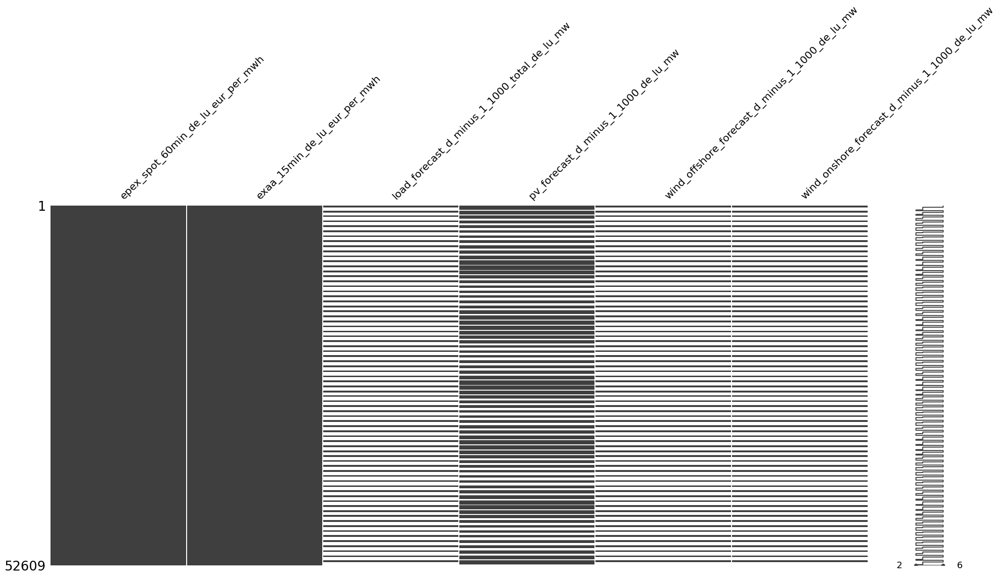

In [38]:
msno.matrix(data.resample("h").mean())

<Axes: >

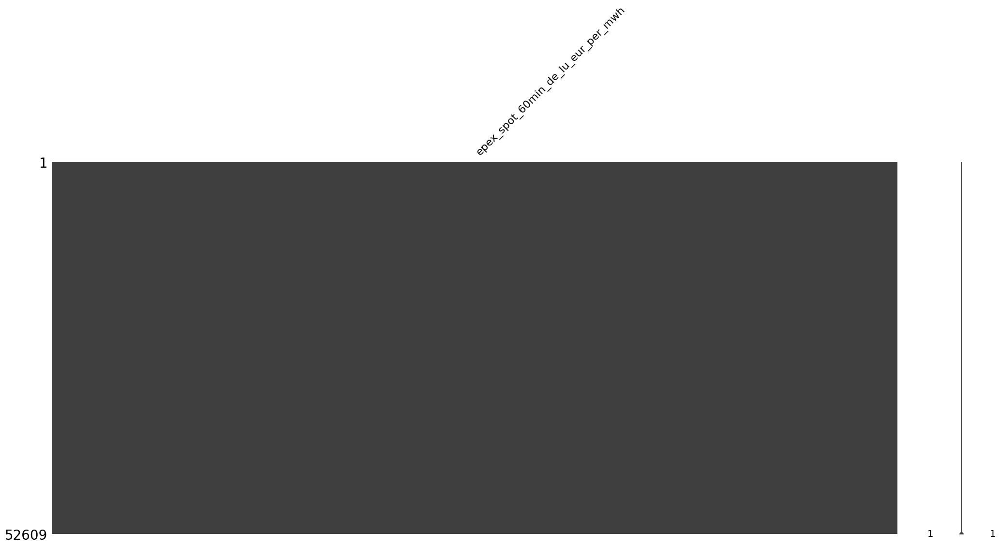

In [39]:
msno.matrix(da_auction_prices)

<Axes: >

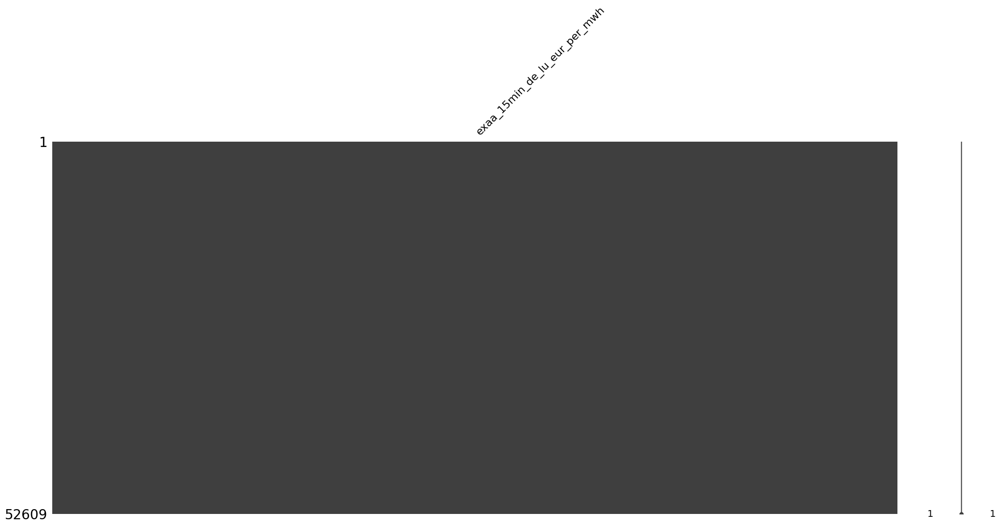

In [11]:
msno.matrix(exaa_prices)

<Axes: >

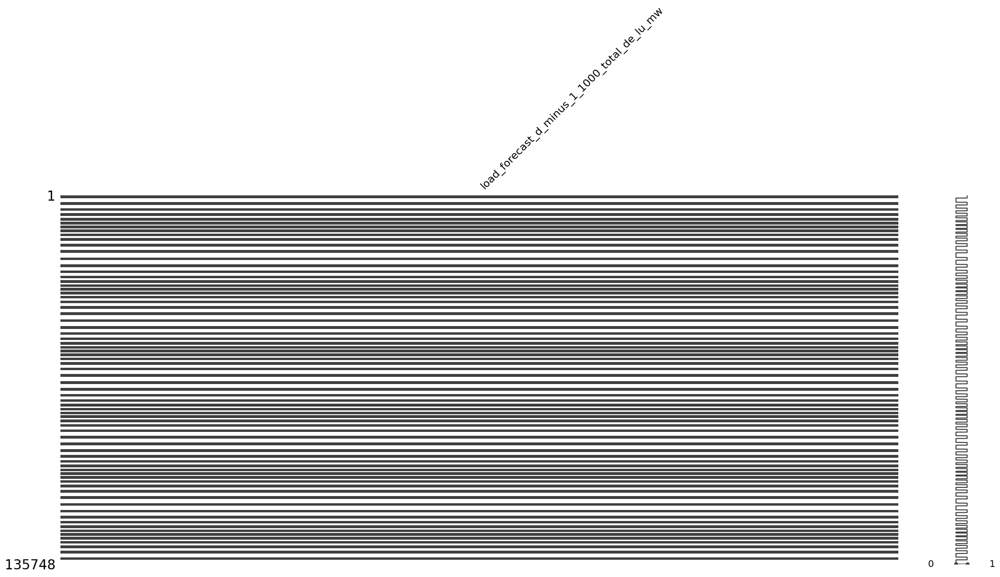

In [40]:
msno.matrix(demand_df)

<Axes: >

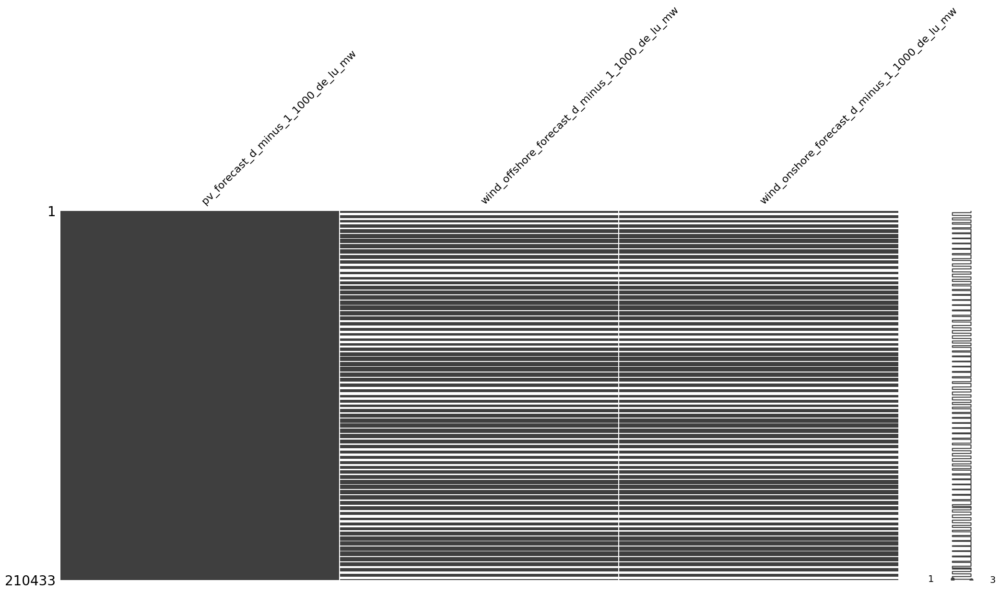

In [13]:
msno.matrix(vre_df)

In [14]:
exaa_prices.plot()

In [16]:
da_auction_prices.plot()

In [17]:
demand_df.plot()

In [18]:
vre_df["pv_forecast_d_minus_1_1000_de_lu_mw"].plot()

In [19]:
vre_df["wind_onshore_forecast_d_minus_1_1000_de_lu_mw"].plot()

In [20]:
vre_df["wind_offshore_forecast_d_minus_1_1000_de_lu_mw"].plot()

In [15]:
vre_df["wind_offshore_forecast_d_minus_1_1000_de_lu_mw"].isna().sum()

np.int64(63729)

# ETL Transaction data from epex spot sftp (old format)

In [24]:
execute_etl_transactions_old_format(years=[2019, 2020])

# ETL Transaction data from epex spot sftp (new format)

In [ ]:
#execute_etl_transactions_new_format(years=[2021, 2022, 2023, 2024, 2025])
execute_etl_transactions_new_format(years=[2024, 2025])

# Calculate ID Full and add to csv file

In [2]:
output_path = Path("data")
output_path.mkdir(exist_ok=True)

csv_path = output_path / "data_2019-01-01_2024-01-01_hourly.csv"

In [3]:
run_build_idfull_and_merge(csv_in=str(csv_path), csv_out=str(csv_path))

,epex_spot_60min_de_lu_eur_per_mwh,exaa_15min_de_lu_eur_per_mwh,load_forecast_d_minus_1_1000_total_de_lu_mw,pv_forecast_d_minus_1_1000_de_lu_mw,wind_offshore_forecast_d_minus_1_1000_de_lu_mw,wind_onshore_forecast_d_minus_1_1000_de_lu_mw,id_full_qh,id_full_h
time,,,,,,,,
2018-12-31 23:00:00+00:00,28.32,28.32,43647.5450,0.0,5068.9000,18879.7900,30.006208,30.006208
2019-01-01 00:00:00+00:00,10.07,10.07,41692.5650,0.0,5042.4425,20626.5625,7.277301,7.277301
2019-01-01 01:00:00+00:00,-4.08,-4.08,40587.2325,0.0,5028.4175,22355.6850,7.113798,7.113798
2019-01-01 02:00:00+00:00,-9.91,-9.91,40308.2500,0.0,4977.6500,24032.4775,1.600135,1.600135
2019-01-01 03:00:00+00:00,-7.41,-7.41,40659.5750,0.0,4907.4000,25452.1675,-1.684348,-1.684348
...,...,...,...,...,...,...,...,...
2025-09-30 18:00:00+00:00,147.28,147.28,59102.0100,0.0,1345.1675,8927.8600,NaN,NaN
2025-09-30 19:00:00+00:00,116.04,116.04,55653.9775,0.0,1571.0275,9325.7475,NaN,NaN
2025-09-30 20:00:00+00:00,101.63,101.63,51992.5850,0.0,1729.2700,8987.1775,NaN,NaN


# Calculate VWAP matrices from epex transaction data

In [66]:
print(f"Data acquisition started for period {DATA_START} to {DATA_END}.")
print(f"Path {PRECOMPUTED_VWAP_PATH}")

# Run precompute VWAPs which computes VWAPS matrices and saves them as parquet files
# VWAPs are stored in PRECOMPUTED_VWAP_PATH defined in shared/config.py
# You can adjust bucket size and min trades as needed
# Matrices are required for Rolling Intrinsic Algortihm

def run_vwap_precompute():
    precompute_range(
        start_day=DATA_START,
        end_day=DATA_END,
        bucket_size=15,
        min_trades=10,
        output_path=PRECOMPUTED_VWAP_PATH,
    )

run_vwap_precompute()

2025-12-02 18:22:08.766 | INFO     | src.data_acquisition.epex_sftp.precompute_vwaps:precompute_vwaps_for_day:77 - Precomputing VWAPs for 2019-01-01


Data acquisition started for period 2019-01-01 00:00:00+01:00 to 2024-01-01 00:00:00+01:00.
Path /Users/timflaschel/Documents/GitHub/BessBidder1/data/precomputed_vwaps


2025-12-02 18:22:12.384 | INFO     | src.data_acquisition.epex_sftp.precompute_vwaps:precompute_vwaps_for_day:169 -  → Saved VWAP matrix to /Users/timflaschel/Documents/GitHub/BessBidder1/data/precomputed_vwaps/vwaps_2019-01-01.parquet
2025-12-02 18:22:12.385 | INFO     | src.data_acquisition.epex_sftp.precompute_vwaps:precompute_vwaps_for_day:77 - Precomputing VWAPs for 2019-01-02
2025-12-02 18:22:15.855 | INFO     | src.data_acquisition.epex_sftp.precompute_vwaps:precompute_vwaps_for_day:169 -  → Saved VWAP matrix to /Users/timflaschel/Documents/GitHub/BessBidder1/data/precomputed_vwaps/vwaps_2019-01-02.parquet
2025-12-02 18:22:15.857 | INFO     | src.data_acquisition.epex_sftp.precompute_vwaps:precompute_vwaps_for_day:77 - Precomputing VWAPs for 2019-01-03
2025-12-02 18:22:19.216 | INFO     | src.data_acquisition.epex_sftp.precompute_vwaps:precompute_vwaps_for_day:169 -  → Saved VWAP matrix to /Users/timflaschel/Documents/GitHub/BessBidder1/data/precomputed_vwaps/vwaps_2019-01-03.pa